<a href="https://colab.research.google.com/github/saiabhiteja/Plant-Disease-Detection/blob/main/Notebooks/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exploratory Data Analysis


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib import cm
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
sns.set(style='darkgrid',rc = {'figure.figsize':(15,8)})
import os
from random import randint
import PIL
plt.rcParams['figure.figsize'] = [10, 8]
import skimage
from skimage.filters import gaussian,median
from skimage import data, img_as_float
from skimage import exposure
import cv2
import warnings
warnings.filterwarnings("ignore")
from tqdm import tqdm

# Relevant Functions

In [ ]:
def image_reader(img_path):
    image = PIL.Image.open(img_path)
    return np.array(image)

def plot_image(image, title):
    plt.title(title)
    plt.imshow(image, cmap='gray')
    plt.show()
    
def image_function(var,title):
    plt.imshow(img)
    plt.grid('off')
    plt.axis('off')
    plt.title(title)
    
def compare(original,filtered,title_filtered="Diseased",cmap_type="gray",axis=False,title_original="Healthy",):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 8), sharex=True, sharey=True)

    ax1.imshow(original, cmap=cmap_type)
    ax1.set_title(title_original)

    ax2.imshow(filtered, cmap=cmap_type)
    ax2.set_title(title_filtered)

    if not axis:
        ax1.axis("off")
        ax2.axis("off")
    plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0.01)
    plt.margins(0, 0)
    plt.show();
    
    
def make_compare():
    healthy_img_ind = randint(0,size_of_health)
    diseased_img_ind = randint(0,size_of_diseased)
    healthy_image =image_reader(health_path+"/"+healthy_dirs[healthy_img_ind])
    diseased_image = image_reader(diseased_path+"/"+diseased_dirs[diseased_img_ind])
    compare(healthy_image,diseased_image)
    
    
def apply_histgram(size,path,dirs):
    index = randint(0,size)
    curr_path = dirs[index]
    image_path = path+'/'+curr_path
    #reading image
    image = image_reader(image_path)
    #applying histogram equlization
    img_eq = exposure.equalize_hist(image)
    return [image,img_eq]


def apply_median(size,path,dirs):
    index = randint(0,size)
    curr_path = dirs[index]
    image_path = path+'/'+curr_path
    #reading image
    image = image_reader(image_path)
    #applying median filtering
    img_eq = median(image)
    return [image,img_eq]


def apply_gaussian(size,path,dirs):
    index = randint(0,size)
    curr_path = dirs[index]
    image_path = path+'/'+curr_path
    #reading image
    image = image_reader(image_path)
    #applying median filtering
    img_eq = gaussian(image)
    return [image,img_eq]


def apply_hsvimage(size,path,dirs):
    index = randint(0,size)
    curr_path = dirs[index]
    image_path = path+'/'+curr_path
    #reading image
    image = image_reader(image_path)
    #applying median filtering
    hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    return [image,hsv_img]


def apply_Histogram_and_hsvimage(size,path,dirs):
    index = randint(0,size)
    curr_path = dirs[index]
    image_path = path+'/'+curr_path
    #reading image
    image = image_reader(image_path)
    hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    #applying median filtering
    img_eq = exposure.equalize_hist(hsv_img)
   
    return [image,img_eq]

# Paths

In [ ]:
data_path = "/kaggle/input/final-year-project-tree/data/data"
diseased_path = "/kaggle/input/final-year-project-tree/data/data/Diseased"
health_path = "/kaggle/input/final-year-project-tree/data/data/healthy"
image_path = "/kaggle/input/final-year-project-tree/data/data/train_images/diseased (1000).JPG"

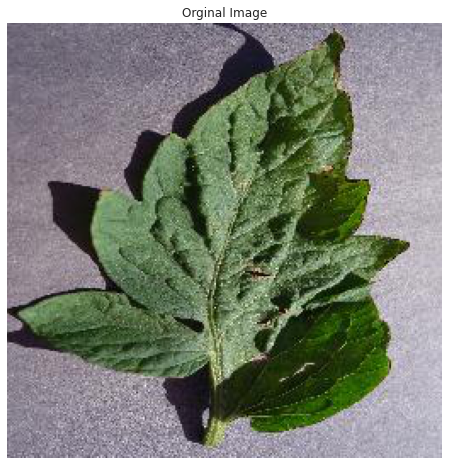

In [ ]:
img = mpimg.imread(image_path)
plt.grid('off')
plt.axis('off')
plt.imshow(img)
plt.title("Orginal Image")
plt.show()

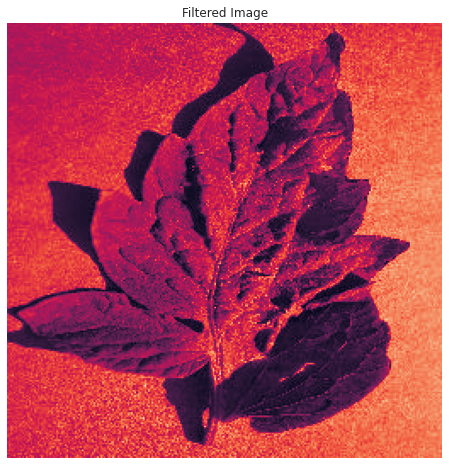

In [ ]:
filterd_img = img[:, :, 0]
plt.grid('off')
plt.axis('off')
plt.imshow(filterd_img)
plt.title("Filtered Image")
plt.show()


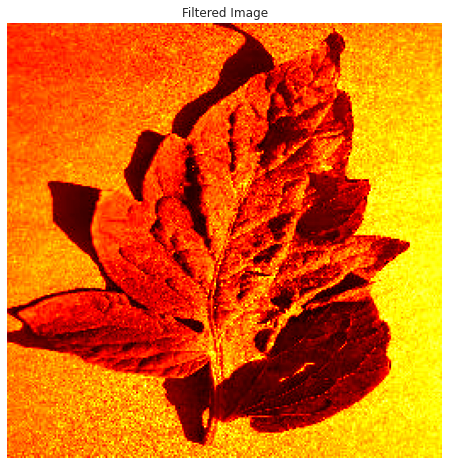

In [ ]:
plt.imshow(filterd_img, cmap="hot")
plt.grid('off')
plt.axis('off')
plt.title("Filtered Image")
plt.show()

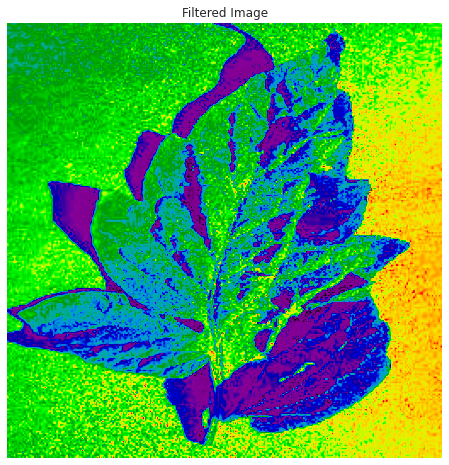

In [ ]:
imgplot = plt.imshow(filterd_img)
imgplot.set_cmap('nipy_spectral')
plt.grid('off')
plt.axis('off')
plt.title("Filtered Image")
plt.show()

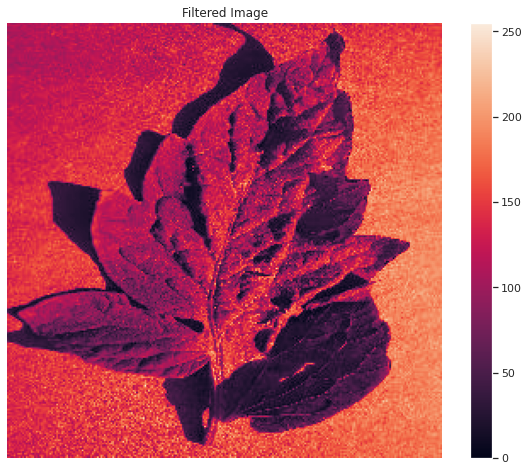

In [ ]:
imgplot = plt.imshow(filterd_img)
plt.colorbar()
plt.grid('off')
plt.axis('off')
plt.title("Filtered Image")
plt.show()

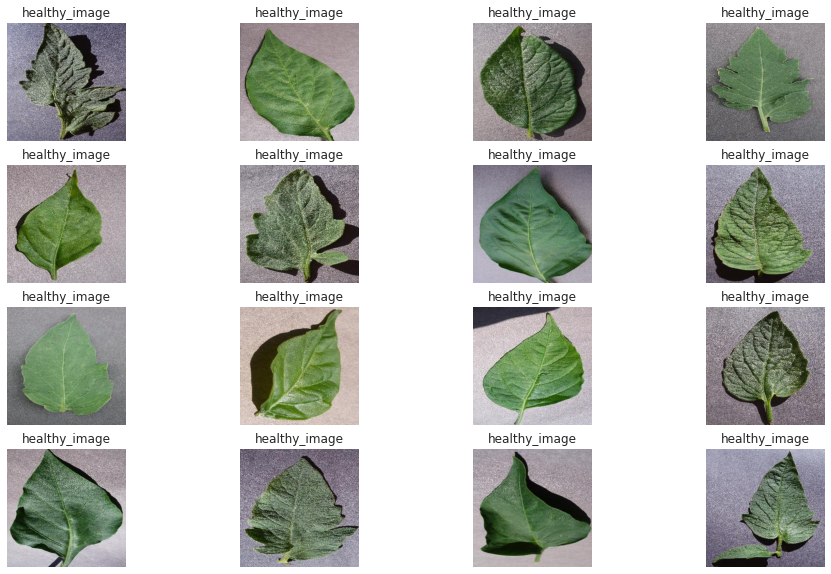

In [ ]:
healthy_dirs = os.listdir(health_path)
size_of_health =  len(os.listdir(health_path))
plt.figure(figsize=(16,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    img_ind = randint(0,size_of_health)
    img = image_reader(health_path+"/"+healthy_dirs[img_ind])
    image_function(img,"healthy_image")

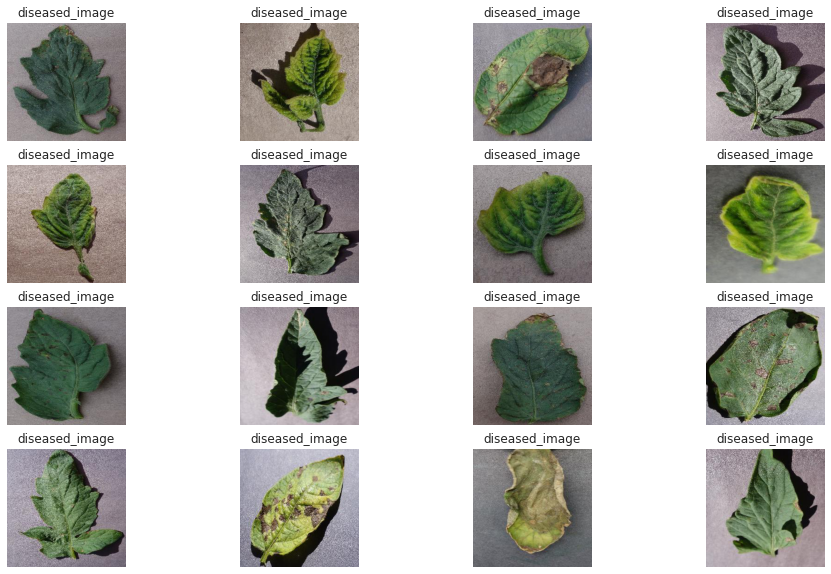

In [ ]:
diseased_dirs = os.listdir(diseased_path)
size_of_diseased =  len(os.listdir(diseased_path))
plt.figure(figsize=(16,10))
for i in range(16):
    ax = plt.subplot(4,4,i+1)
    img_ind = randint(0,size_of_diseased)
    img = image_reader(diseased_path+"/"+diseased_dirs[img_ind])
    image_function(img,"diseased_image")

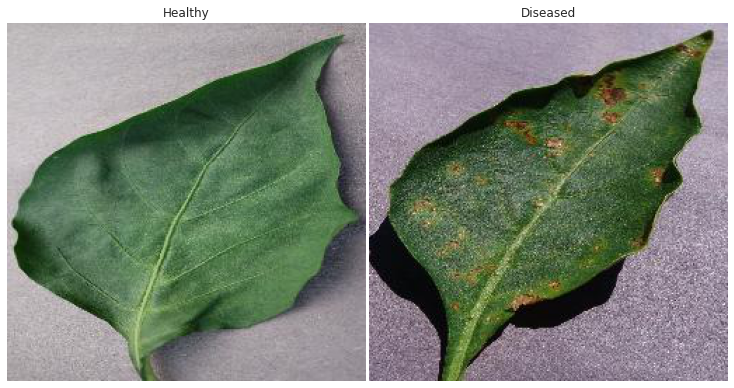

In [ ]:
make_compare()

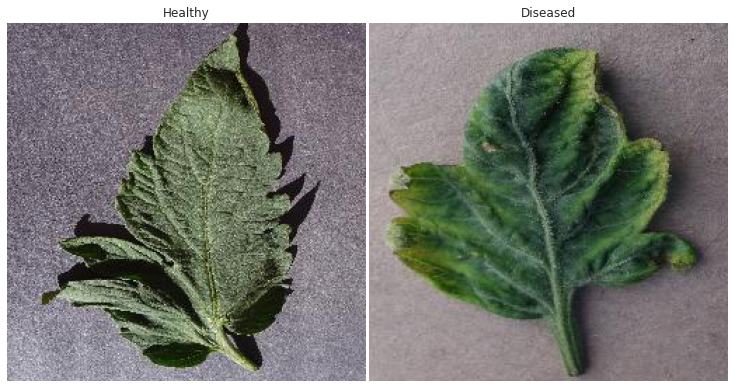

In [ ]:
make_compare()

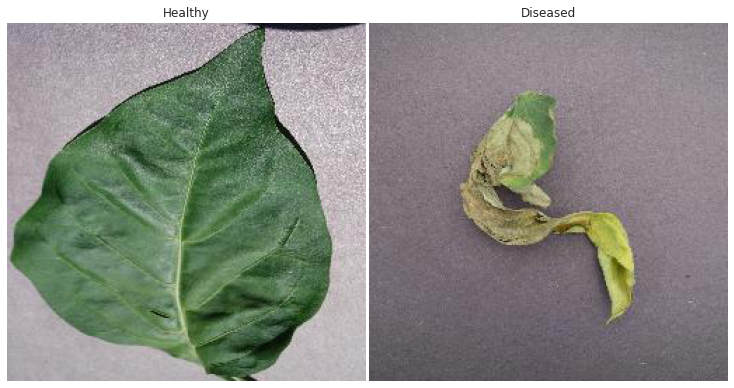

In [ ]:
make_compare()

In [ ]:
extensions = ['jpg','JPG']

In [ ]:
count = 0 
for img in healthy_dirs:
    li = img.split('.')
    end = li[-1]
    if end not in extensions:
        count+=1
print(count)

1


In [ ]:
count = 0 
for img in diseased_dirs:
    li = img.split('.')
    end = li[-1]
    if end not in extensions:
        count+=1
print(count)

1


<div style="color:white;
           display:fill;
           border-radius:5px;
           background-color:#ff3700;
           font-size:110%;
           font-family:Verdana;
           letter-spacing:0.5px">
    <h1 style="padding: 10px; color:white; font-weight: bold; font-size : 22px;">
📊Conclusions </h1>
</div>

<div class="alert alert-block alert-success">  
<dl>
<dt style="color: black" >📍 Healthy Images : </dt>
    <dd>- Number of Images : 3221.</dd>
    <dd>- Number of Images with extensions : 3220.</dd>
    <dd>- Number of Images without extensions: 1.</dd>
</dl>
</div>

<div class="alert alert-block alert-info">  
<dl>
<dt style="color: black">📍 Diseased Images : </dt>
    <dd>- Number of Images : 13019</dd>
    <dd>- Number of Images with extensions : 13017.</dd>
    <dd>- Number of Images without extensions: 2.</dd>
</dl>
</div>

# Preprocessing

# Applying Histogram Equalization Filter

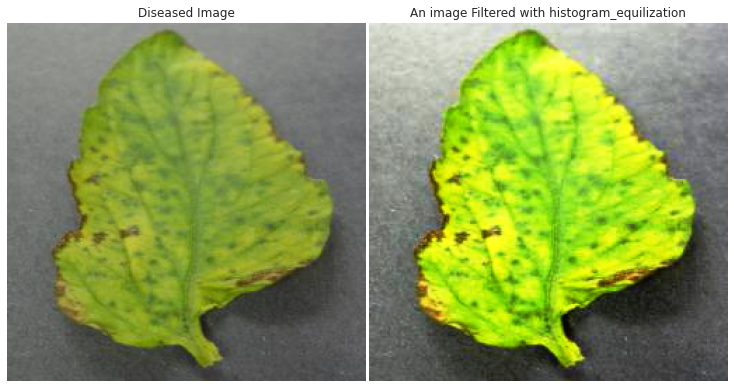

In [ ]:
curr = apply_histgram(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with histogram_equilization",title_original = "Diseased Image")

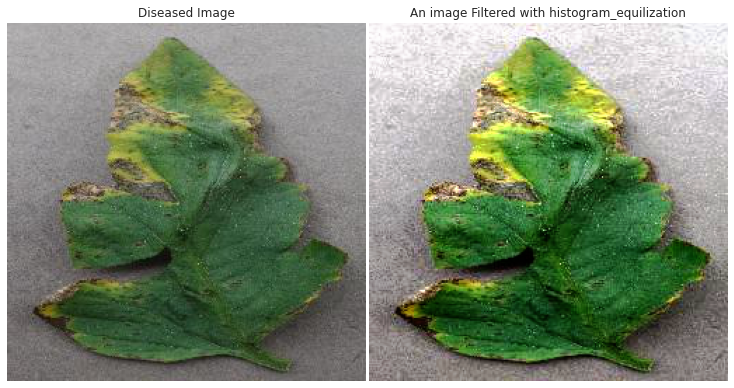

In [ ]:
curr = apply_histgram(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with histogram_equilization",title_original = "Diseased Image")

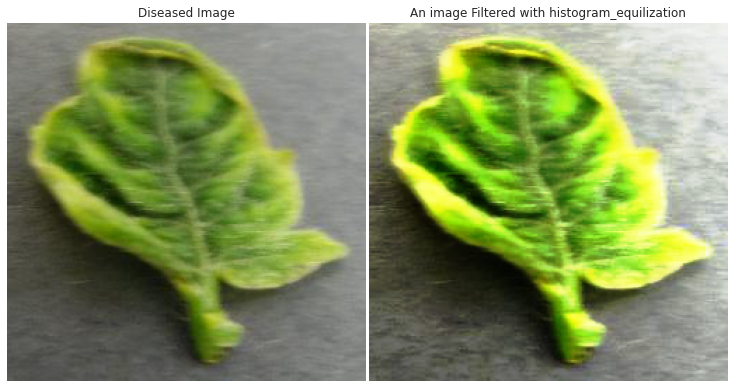

In [ ]:
curr = apply_histgram(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with histogram_equilization",title_original = "Diseased Image")

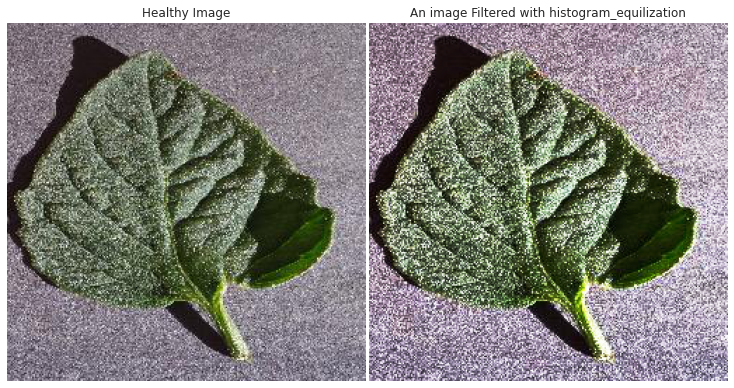

In [ ]:
curr = apply_histgram(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Filtered with histogram_equilization",title_original = "Healthy Image")

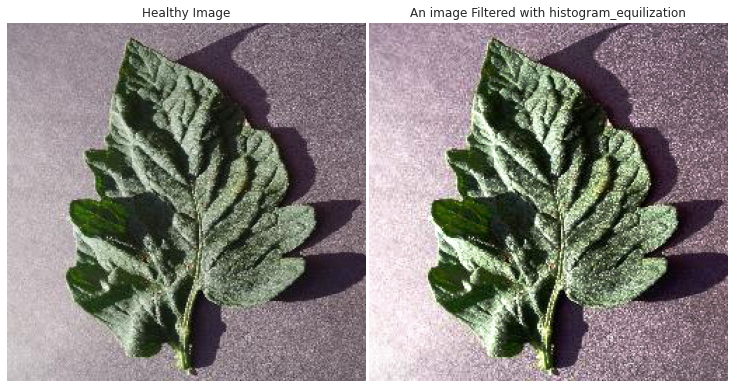

In [ ]:
curr = apply_histgram(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with histogram_equilization",title_original = "Healthy Image")

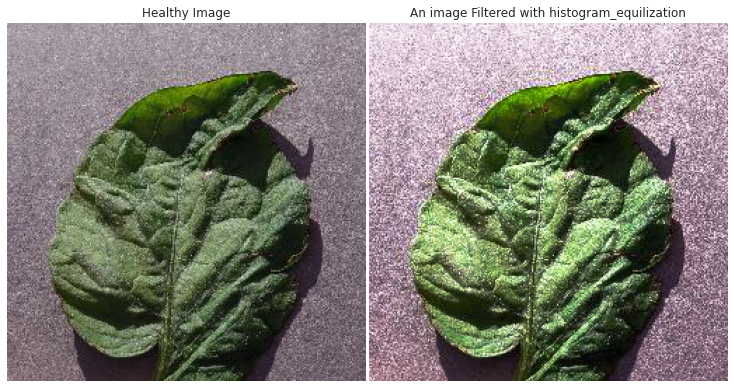

In [ ]:
curr = apply_histgram(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with histogram_equilization",title_original = "Healthy Image")

# Applying Median Filtering

In [ ]:
# curr = apply_median(size_of_diseased,diseased_path,diseased_dirs)
# compare(curr[0],curr[1],"An image Filtered with Median Filtering",title_original = "diseased_image")

In [ ]:
# curr = apply_median(size_of_diseased,diseased_path,diseased_dirs)
# compare(curr[0],curr[1],"An image Filtered with Median Filtering",title_original = "diseased_image")

In [ ]:
# curr = apply_median(size_of_diseased,diseased_path,diseased_dirs)
# compare(curr[0],curr[1],"An image Filtered with Median Filtering",title_original = "diseased_image")

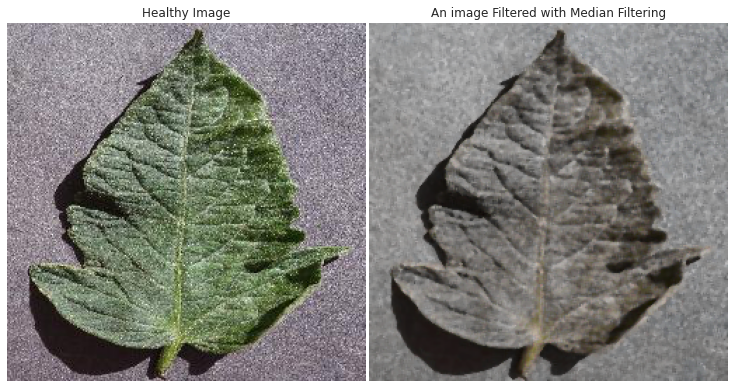

In [ ]:
curr = apply_median(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Filtered with Median Filtering",title_original = "Healthy Image")

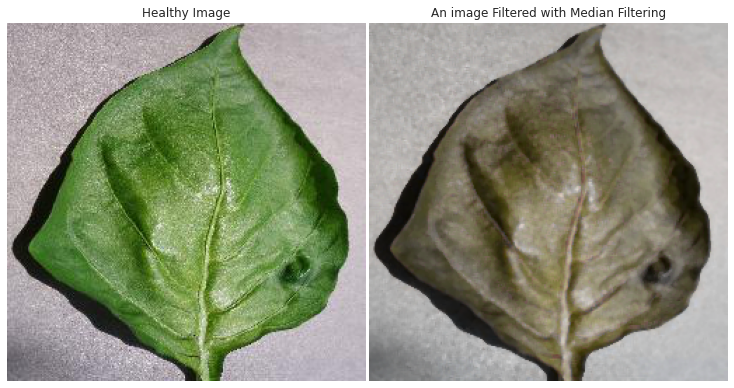

In [ ]:
curr = apply_median(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Filtered with Median Filtering",title_original = "Healthy Image")

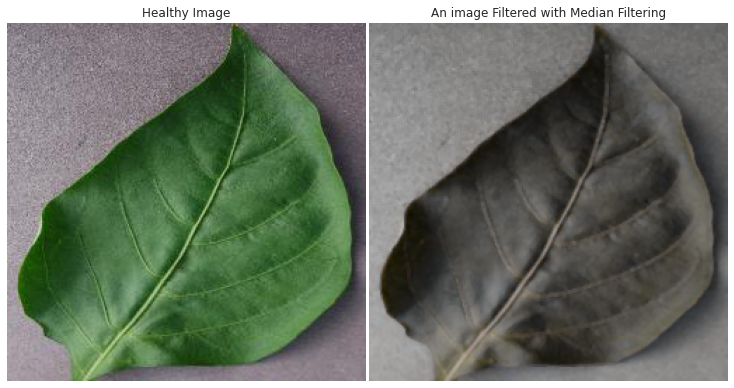

In [ ]:
curr = apply_median(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Filtered with Median Filtering",title_original = "Healthy Image")

# Applying Gaussian Bluring

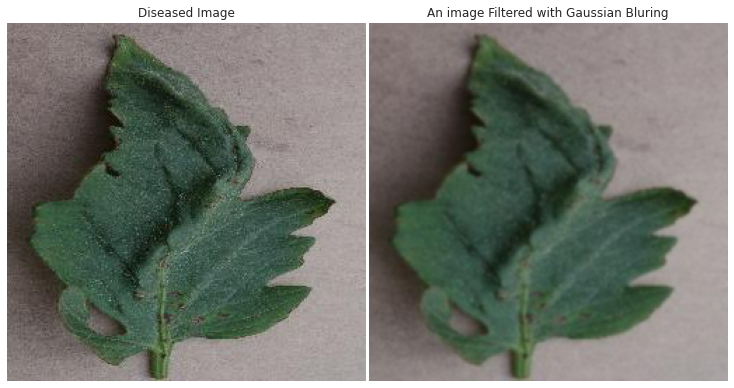

In [ ]:
curr = apply_gaussian(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Diseased Image")

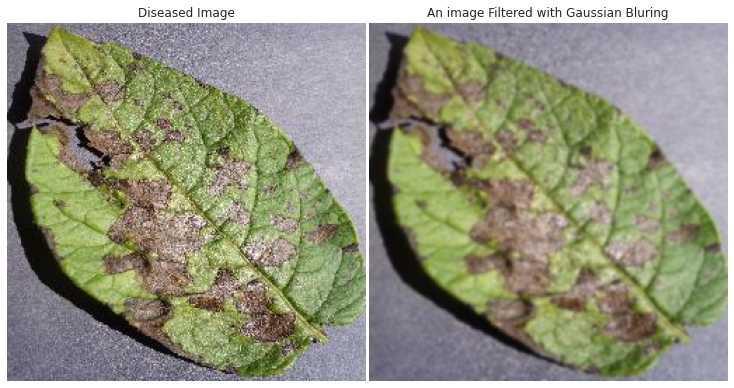

In [ ]:
curr = apply_gaussian(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Diseased Image")

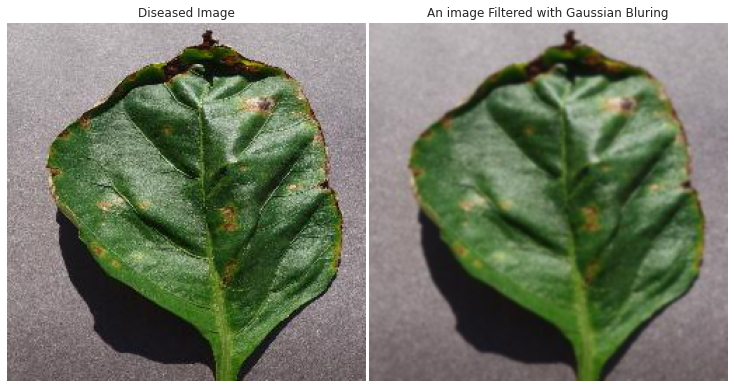

In [ ]:
curr = apply_gaussian(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Diseased Image")

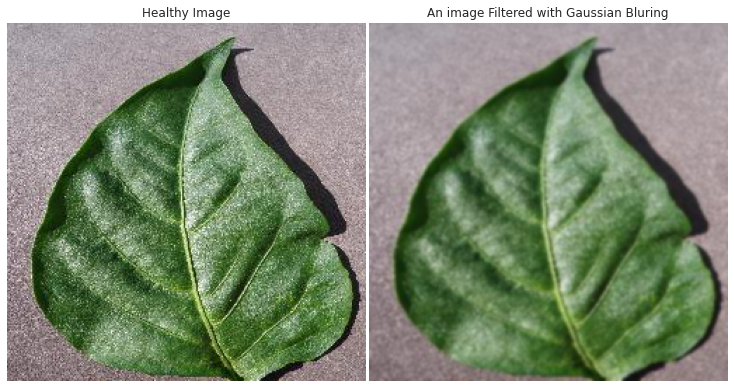

In [ ]:
curr = apply_gaussian(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Healthy Image")

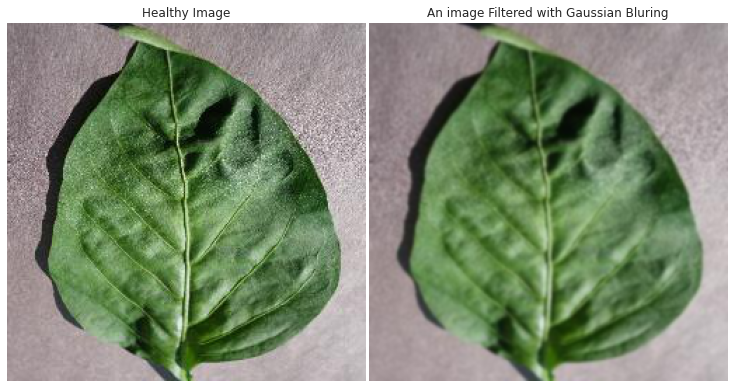

In [ ]:
curr = apply_gaussian(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Healthy Image")

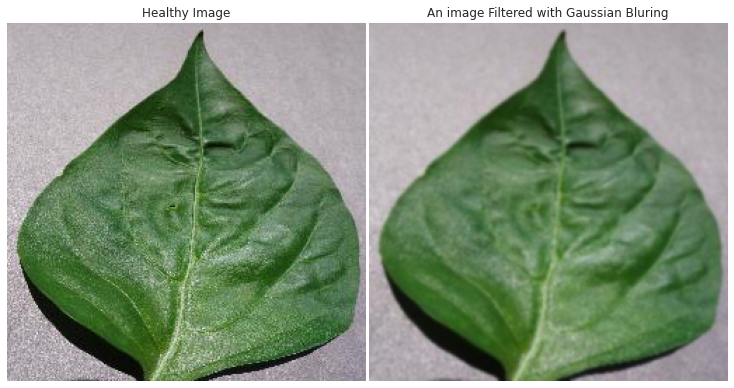

In [ ]:
curr = apply_gaussian(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Healthy Image")

# Converting RGB Image into Hsv Image

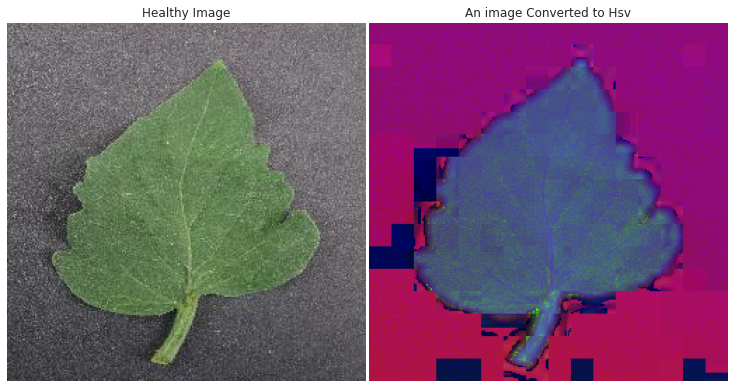

In [ ]:
curr = apply_hsvimage(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Converted to Hsv",title_original = "Healthy Image")

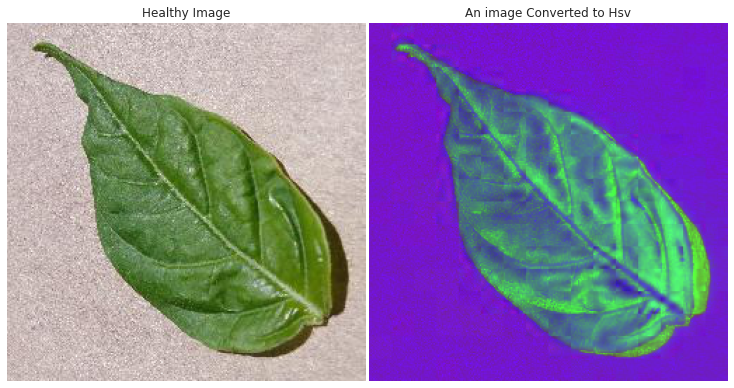

In [ ]:
curr = apply_hsvimage(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Converted to Hsv",title_original = "Healthy Image")

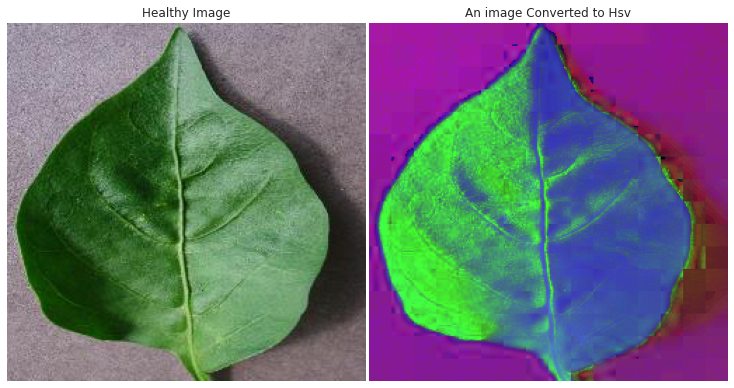

In [ ]:
curr = apply_hsvimage(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"An image Converted to Hsv",title_original = "Healthy Image")

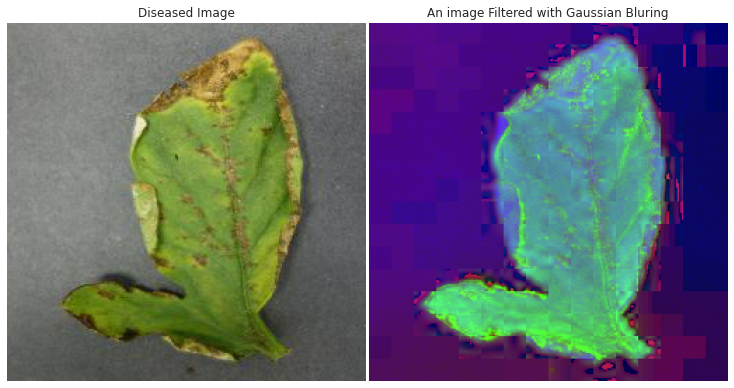

In [ ]:
curr = apply_hsvimage(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Diseased Image")

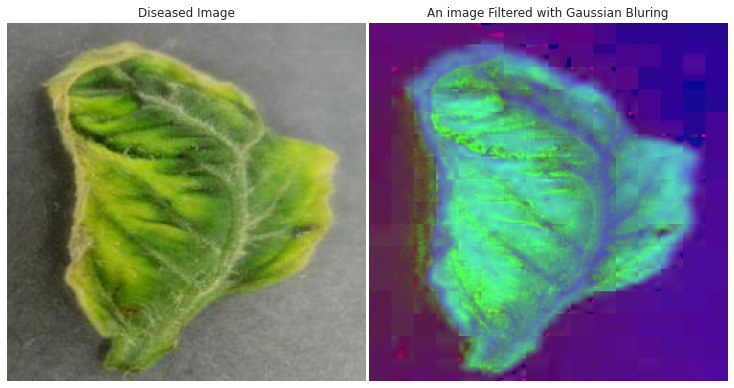

In [ ]:
curr = apply_hsvimage(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Diseased Image")

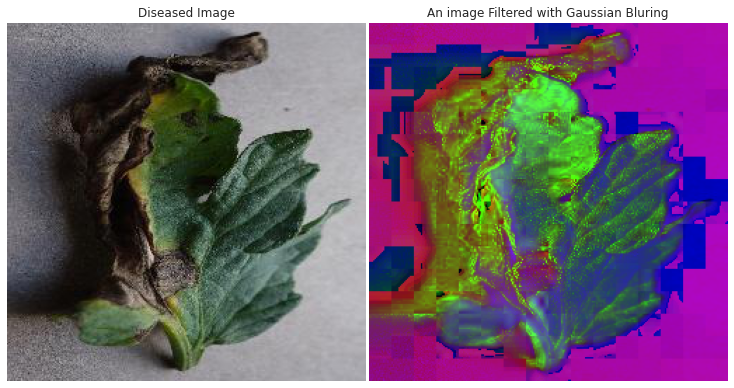

In [ ]:
curr = apply_hsvimage(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"An image Filtered with Gaussian Bluring",title_original = "Diseased Image")

# Applying Histogram Equalization and Coverting it into HSV Image

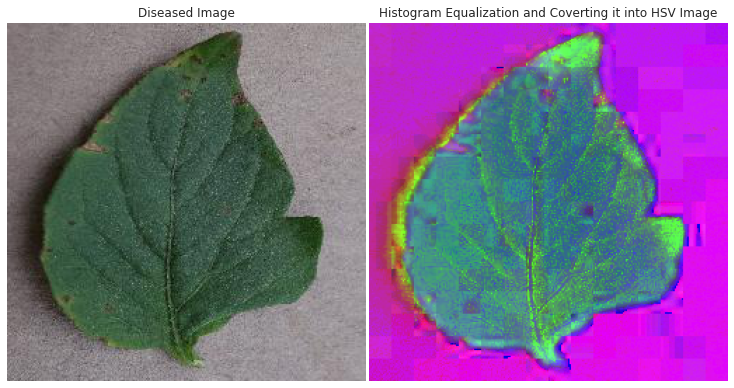

In [ ]:
curr = apply_Histogram_and_hsvimage(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"Histogram Equalization and Coverting it into HSV Image",title_original = "Diseased Image")

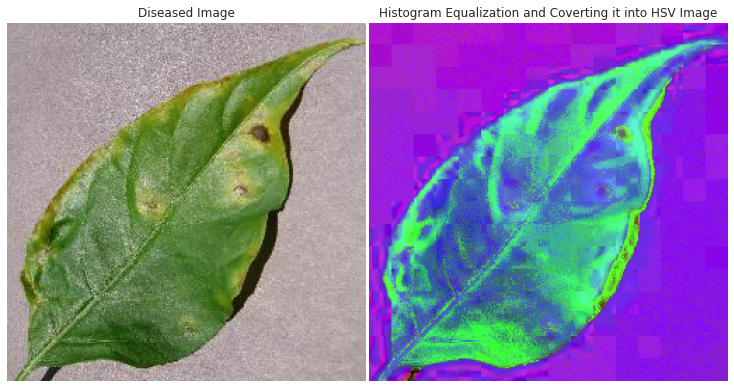

In [ ]:
curr = apply_Histogram_and_hsvimage(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"Histogram Equalization and Coverting it into HSV Image",title_original = "Diseased Image")

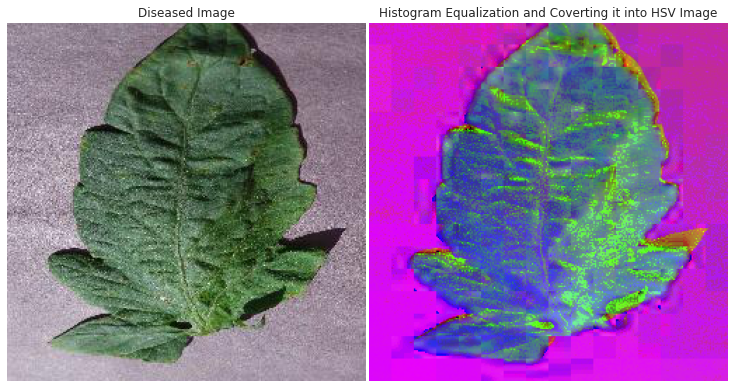

In [ ]:
curr = apply_Histogram_and_hsvimage(size_of_diseased,diseased_path,diseased_dirs)
compare(curr[0],curr[1],"Histogram Equalization and Coverting it into HSV Image",title_original = "Diseased Image")

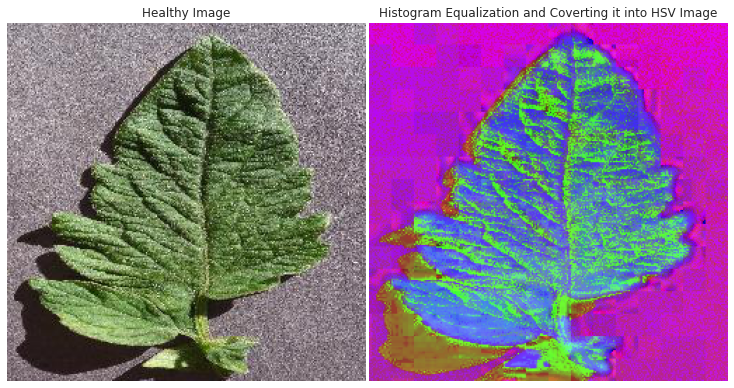

In [ ]:
curr = apply_Histogram_and_hsvimage(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"Histogram Equalization and Coverting it into HSV Image",title_original = "Healthy Image")

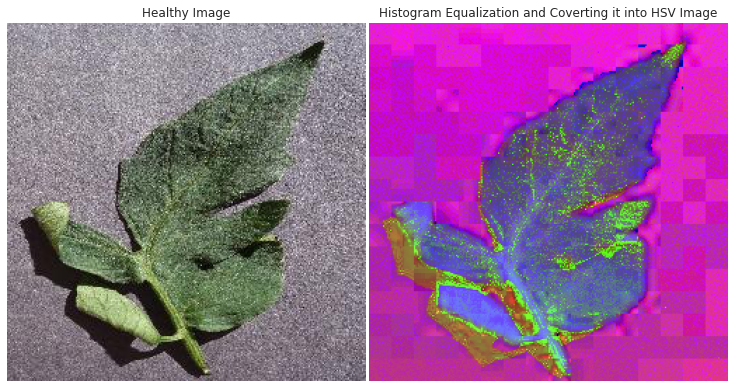

In [ ]:
curr = apply_Histogram_and_hsvimage(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"Histogram Equalization and Coverting it into HSV Image",title_original = "Healthy Image")

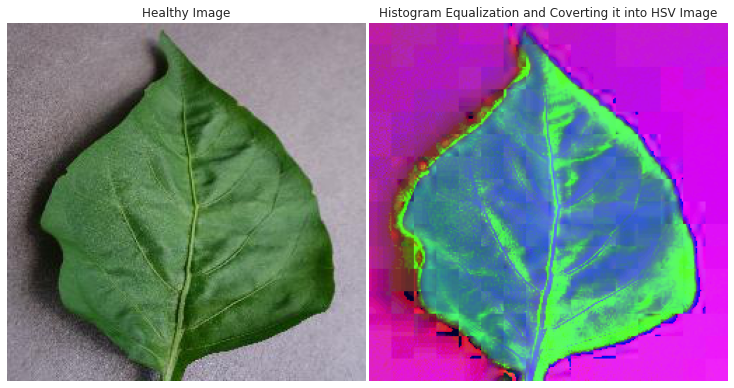

In [ ]:
curr = apply_Histogram_and_hsvimage(size_of_health,health_path,healthy_dirs)
compare(curr[0],curr[1],"Histogram Equalization and Coverting it into HSV Image",title_original = "Healthy Image")

<div style="color:white;
           display:fill;
           border-radius:5px;
           background-color:#ff3700;
           font-size:110%;
           font-family:Verdana;
           letter-spacing:0.5px">
    <h1 style="padding: 10px; color:white; font-weight: bold; font-size : 22px;">
📊Conclusions </h1>
</div>

<div class="alert alert-block alert-success">  
<dl>
<dt style="color: black" >📍 Preprocessing : </dt>
    <dd>- Reading RGB Image and Then converting it into Hsv Image and then Applying Histogram Equalization To the image.</dd>
    
</dl>
</div>

